In [ ]:
import os

def download_and_setup_test_dataset():
    """
    Downloading the test dataset.
    """
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/test_database.tar')

    datasets_path = "datasets"
    if not os.path.exists(datasets_path):
        os.makedirs(datasets_path)

    # put the test dataset in datasets/test
    os.system("tar xf test_database.tar -C 'datasets' --one-top-level && mv test_database.tar datasets/test")


def download_and_setup_small_dataset():
    """
    Downloading the small dataset.

    """
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_small.tar')

    datasets_path = "datasets"
    if not os.path.exists(datasets_path):
        os.makedirs(datasets_path)

    # put the small dataset in datasets/small
    os.system(
        "tar xf defi1certif-datasets-fire_small.tar -C 'datasets' --one-top-level && mv "
        "datasets/defi1certif-datasets-fire_small datasets/small")


def download_and_setup_medium_dataset():
    """
    Downloading the medium dataset.
    """
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_medium.tar.001')
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_medium.tar.002')
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_medium.tar.003')

    datasets_path = "datasets"
    if not os.path.exists(datasets_path):
        os.makedirs(datasets_path)

    # recombine the tar files
    os.system("cat  defi1certif-datasets-fire_medium.tar.001 defi1certif-datasets-fire_medium.tar.002 "
              "defi1certif-datasets-fire_medium.tar.003 >> defi1certif-datasets-fire_medium.tar")

    # put the medium dataset in datasets/medium
    os.system("tar xf defi1certif-datasets-fire_medium.tar -C 'datasets' --one-top-level && mv "
              "datasets/defi1certif-datasets-fire_medium datasets/medium")


def download_and_setup_large_dataset():
    """
    Downloading the large dataset.
    """
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_big.tar.001')
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_big.tar.002')
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_big.tar.003')
    os.system(
        'wget https://github.com/belarbi2733/keras_yolov3/releases/download/1/defi1certif-datasets-fire_big.tar.004')

    datasets_path = "datasets"
    if not os.path.exists(datasets_path):
        os.makedirs(datasets_path)

    # recombine the tar files
    os.system("cat  defi1certif-datasets-fire_big.tar.001 defi1certif-datasets-fire_big.tar.002 "
              "defi1certif-datasets-fire_big.tar.003 defi1certif-datasets-fire_big.tar.004 >> "
              "defi1certif-datasets-fire_big.tar")

    # put the large dataset in datasets/large
    os.system("tar xf defi1certif-datasets-fire_big.tar -C 'datasets' --one-top-level && mv "
              "datasets/defi1certif-datasets-fire_big datasets/large")


def setup_full_dataset():
    """
    Downloads and sets up all datasets in a single folder named all.
    A folder per class is created.
    """
    download_and_setup_small_dataset()
    download_and_setup_medium_dataset()
    download_and_setup_large_dataset()

    # creating the folder to merge datasets
    if not os.path.exists("datasets/all"):
        os.makedirs("datasets/all")
    if not os.path.exists("datasets/all/fire"):
        os.makedirs("datasets/all/fire")
    if not os.path.exists("datasets/all/no_fire"):
        os.makedirs("datasets/all/no_fire")
    if not os.path.exists("datasets/all/start_fire"):
        os.makedirs("datasets/all/start_fire")

    # moving images from the small dataset to the full dataset
    os.system("find datasets/small/fire -type f -print0 | xargs -0 mv -t datasets/all/fire/")
    os.system("find datasets/small/no_fire -type f -print0 | xargs -0 mv -t datasets/all/no_fire/")
    os.system("find datasets/small/start_fire -type f -print0 | xargs -0 mv -t datasets/all/start_fire/")

    # moving images from the medium dataset to the full dataset
    os.system("find datasets/medium/fire -type f -print0 | xargs -0 mv -t datasets/all/fire/")
    os.system("find datasets/medium/no_fire -type f -print0 | xargs -0 mv -t datasets/all/no_fire/")
    os.system("find datasets/medium/start_fire -type f -print0 | xargs -0 mv -t datasets/all/start_fire/")

    # moving images from the large dataset to the full dataset
    os.system("find datasets/large/fire -type f -print0 | xargs -0 mv -t datasets/all/fire/")
    os.system("find datasets/large/no_fire -type f -print0 | xargs -0 mv -t datasets/all/no_fire/")
    os.system("find datasets/large/start_fire -type f -print0 | xargs -0 mv -t datasets/all/start_fire/")

In [ ]:
import imghdr
import math
import os
import numpy as np
from keras import Model
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input as inception_preprocess_input
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input as vgg16_preprocess_input
from keras.callbacks import ModelCheckpoint, TensorBoard
from keras.layers import GlobalAveragePooling2D, Dense
from keras.preprocessing import image
from keras.utils import np_utils
from matplotlib import pyplot as plt


classes = ['fire', 'no_fire', 'start_fire']
nbr_classes = 3


def generate_from_paths_and_labels(images_paths, labels, batch_size, preprocessing, image_size=(224, 224)):
    """
    Generator to give to the fit function, generates batches of samples for training.
    This avoids to load the full dataset in memory. This can also be a Keras class.
    :param images_paths:
    :param labels:
    :param batch_size:
    :param image_size:
    :param preprocessing:
    :return:
    """
    number_samples = len(images_paths)
    while 1:
        perm = np.random.permutation(number_samples)  # randomize the order of the images (to be done after each epoch)

        # apply the permutations
        images_paths = images_paths[perm]
        labels = labels[perm]

        # from 0 to number_samples by batch_size increment to generate batches
        # this assumes there are number_samples / batch_size batches in an epoch
        # which ensures that each samples is only fed once to the network at each epoch
        for i in range(0, number_samples, batch_size):
            # a batch is a list of image paths : images_paths[i:i + batch_size]
            # map transforms all paths to images using keras.preprocessing.image
            inputs = list(map(
                lambda x: image.load_img(x, target_size=image_size),
                images_paths[i:i + batch_size]
            ))
            # converting the loaded images to numpy arrays
            inputs = np.array(list(map(
                lambda x: image.img_to_array(x),
                inputs
            )))

            # preprocessing the batch might notably normalize between 0 and 1 the RGB values, this is model-dependant
            inputs = preprocessing(inputs)

            # yields the image batch and corresponding labels
            yield (inputs, labels[i:i + batch_size])


def extract_dataset(dataset_path, classes_names, percentage):
    """
    Assumes that dataset_path/classes_names[0] is a folder containing all images of class classes_names[0].
    All image paths are loaded into a numpy array, corresponding labels are one-hot encoded and put into a numpy array.
    Samples are shuffled before splitting into training and validation sets to prevent problems since samples are loaded
    in order of their class.
    :param dataset_path: path to the root of the dataset.
    :param classes_names: names of the classes.
    :param percentage: percentage of samples to be used for training, the rest is for validation. Must be in [0,1].
    :return: (x_train, y_train), (x_val, y_val) a list of image paths and a list of corresponding labels for training
    and validation.
    """

    num_classes = len(classes_names)

    # putting images paths and labels in lists
    images_paths, labels = [], []
    for class_name in os.listdir(dataset_path):
        class_path = os.path.join(dataset_path, class_name)
        class_id = classes_names.index(class_name)  # class id = index of the class_name in classes_name, later o-h enc
        # here we are considering all paths for images labeled class_id
        for path in os.listdir(class_path):
            path = os.path.join(class_path, path)  # image path
            # test the image data contained in the file , and returns a string describing the image type
            if imghdr.what(path) is None:
                # this is not an image file
                continue
            images_paths.append(path)
            labels.append(class_id)

    # one-hot encode the labels
    labels_oh = np_utils.to_categorical(labels, num_classes)
    # convert images_paths to numpy array to apply permutation
    images_paths = np.array(images_paths)

    number_samples = len(images_paths)
    perm = np.random.permutation(number_samples)
    labels_oh = labels_oh[perm]
    images_paths = images_paths[perm]

    # 90% of samples used for training
    border = math.floor(percentage * len(images_paths))

    train_labels, val_labels = labels_oh[:border], labels_oh[border:]
    train_samples, val_samples = images_paths[:border], images_paths[border:]

    print("Training on %d samples" % (len(train_samples)))
    print("Validation on %d samples" % (len(val_samples)))

    return (train_samples, train_labels), (val_samples, val_labels)

def graphically_test_model(model_path, classes_names, test_image_dir, preprocess_input, image_size=(224, 224)):
    """
    Loads a model, does a prediction on each image in test_image_dir and displays the image with the class name on
    top of it.
    :param model_path:
    :param classes_names:
    :param test_image_dir:
    :param preprocess_input:
    :param image_size:
    """
    nbr_classes = len(classes_names)
    model = load_model(model_path)

    for test_image_path in os.listdir(test_image_dir):
        # load image using keras
        img = image.load_img(test_image_dir + "/" + test_image_path, target_size=image_size)

        # processed image to feed the network
        processed_img = image.img_to_array(img)
        processed_img = np.expand_dims(processed_img, axis=0)
        processed_img = preprocess_input(processed_img)

        # get prediction using the network
        predictions = model.predict(processed_img)[0]
        # transform [0,1] values into percentages and associate it to its class name (class_name order was used to
        # one-hot encode the classes)
        result = [(classes_names[i], float(predictions[i]) * 100.0) for i in range(nbr_classes)]
        # sort the result by percentage
        result.sort(reverse=True, key=lambda x: x[1])

        # load image for displaying
        img = cv2.imread(test_image_dir + "/" + test_image_path)
        # transform into RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        font = cv2.FONT_HERSHEY_COMPLEX

        # write class percentages on the image
        for i in range(nbr_classes):
            (class_name, prob) = result[i]
            textsize = cv2.getTextSize(class_name, font, 1, 2)[0]
            textX = (img.shape[1] - textsize[0]) / 2
            textY = (img.shape[0] + textsize[1]) / 2
            if (i == 0):
                cv2.putText(img, class_name, (int(textX) - 100, int(textY)), font, 5, (255, 255, 255), 6, cv2.LINE_AA)
            print("Top %d ====================" % (i + 1))
            print("Class name: %s" % (class_name))
            print("Probability: %.2f%%" % (prob))
        plt.imshow(img)
        plt.show()


def evaluate_model(model_path, classes, preprocessing, dataset_path):
    """
    Loads a model and evaluates the model (metrics) on images provided in folder a dataset.
    :param model_path:
    :param classes:
    :param preprocessing:
    :param test_dataset:
    """
    # For simplicity, the dataset is loaded using 99.9% of images
    (train_samples, train_labels), (val_samples, val_labels) = extract_dataset(dataset_path, classes, 0)
    batch_size = 16
    nbr_val_samples = len(val_samples)
    validation_sample_generator = generate_from_paths_and_labels(val_samples, val_labels, batch_size, preprocessing,
                                                                 image_size=(224, 224, 3))

    model = load_model(model_path)
    return model.evaluate_generator(validation_sample_generator, steps=math.ceil(nbr_val_samples / 16),
                             max_queue_size=10, workers=1, use_multiprocessing=True, verbose=1)


Using TensorFlow backend.


In [ ]:
download_and_setup_test_dataset()

Top 1 ====================
Class name: no_fire
Probability: 99.94%
Top 2 ====================
Class name: start_fire
Probability: 0.05%
Top 3 ====================
Class name: fire
Probability: 0.01%


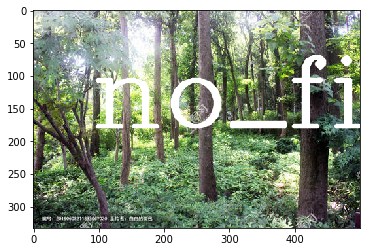

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


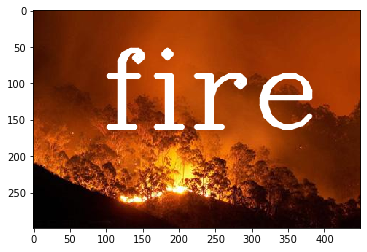

Top 1 ====================
Class name: no_fire
Probability: 99.94%
Top 2 ====================
Class name: start_fire
Probability: 0.05%
Top 3 ====================
Class name: fire
Probability: 0.00%


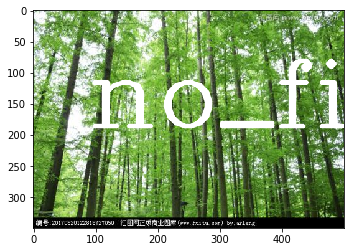

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


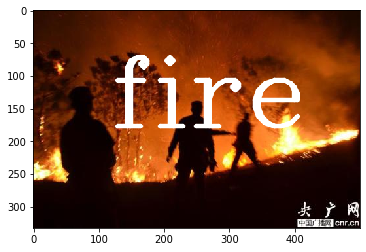

Top 1 ====================
Class name: fire
Probability: 99.99%
Top 2 ====================
Class name: no_fire
Probability: 0.01%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


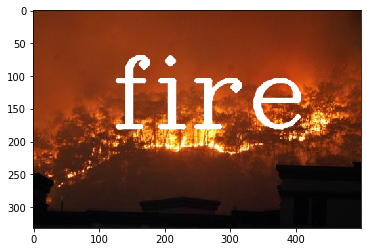

Top 1 ====================
Class name: start_fire
Probability: 99.60%
Top 2 ====================
Class name: no_fire
Probability: 0.26%
Top 3 ====================
Class name: fire
Probability: 0.15%


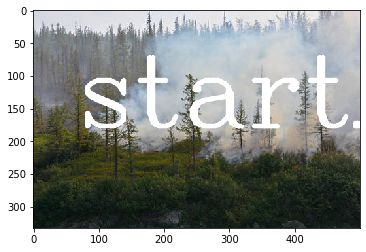

Top 1 ====================
Class name: no_fire
Probability: 99.83%
Top 2 ====================
Class name: start_fire
Probability: 0.17%
Top 3 ====================
Class name: fire
Probability: 0.01%


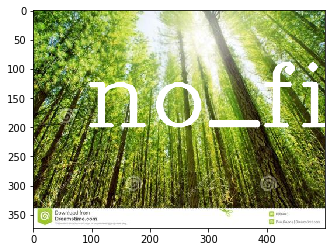

Top 1 ====================
Class name: no_fire
Probability: 42.10%
Top 2 ====================
Class name: start_fire
Probability: 31.56%
Top 3 ====================
Class name: fire
Probability: 26.34%


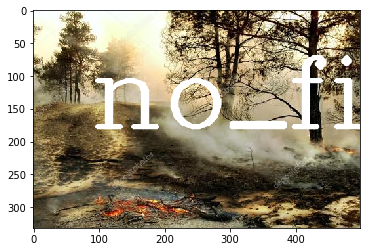

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


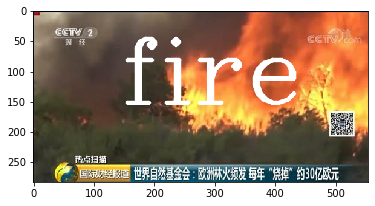

Top 1 ====================
Class name: fire
Probability: 98.41%
Top 2 ====================
Class name: no_fire
Probability: 1.54%
Top 3 ====================
Class name: start_fire
Probability: 0.05%


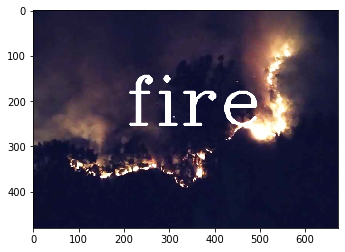

Top 1 ====================
Class name: fire
Probability: 53.12%
Top 2 ====================
Class name: start_fire
Probability: 46.85%
Top 3 ====================
Class name: no_fire
Probability: 0.03%


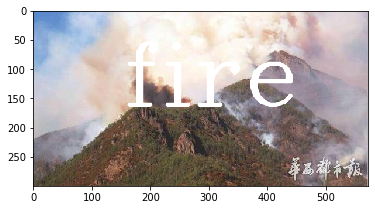

Top 1 ====================
Class name: fire
Probability: 60.47%
Top 2 ====================
Class name: no_fire
Probability: 37.85%
Top 3 ====================
Class name: start_fire
Probability: 1.68%


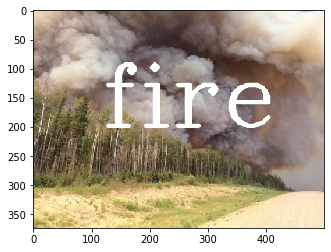

Top 1 ====================
Class name: fire
Probability: 99.96%
Top 2 ====================
Class name: start_fire
Probability: 0.04%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


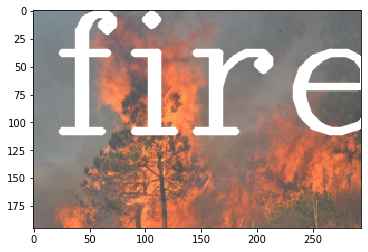

Top 1 ====================
Class name: start_fire
Probability: 99.72%
Top 2 ====================
Class name: no_fire
Probability: 0.27%
Top 3 ====================
Class name: fire
Probability: 0.01%


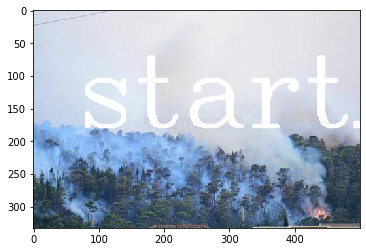

Top 1 ====================
Class name: start_fire
Probability: 91.27%
Top 2 ====================
Class name: fire
Probability: 4.76%
Top 3 ====================
Class name: no_fire
Probability: 3.98%


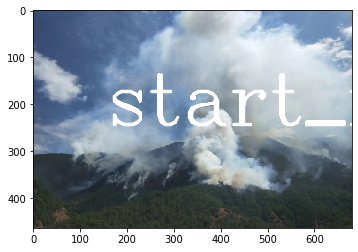

Top 1 ====================
Class name: start_fire
Probability: 98.09%
Top 2 ====================
Class name: fire
Probability: 1.82%
Top 3 ====================
Class name: no_fire
Probability: 0.08%


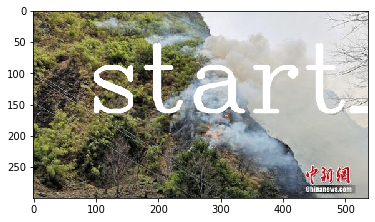

Top 1 ====================
Class name: fire
Probability: 99.73%
Top 2 ====================
Class name: no_fire
Probability: 0.27%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


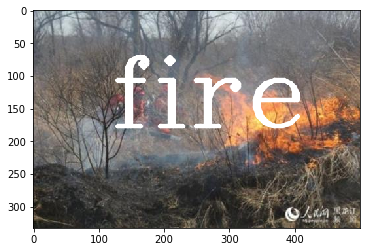

Top 1 ====================
Class name: no_fire
Probability: 100.00%
Top 2 ====================
Class name: fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


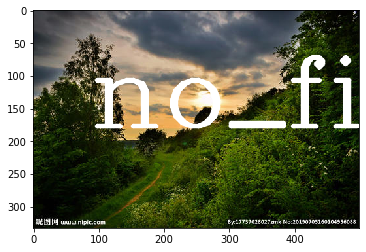

Top 1 ====================
Class name: no_fire
Probability: 99.88%
Top 2 ====================
Class name: start_fire
Probability: 0.11%
Top 3 ====================
Class name: fire
Probability: 0.01%


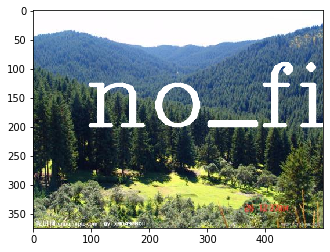

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


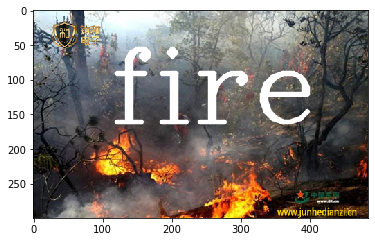

Top 1 ====================
Class name: start_fire
Probability: 88.84%
Top 2 ====================
Class name: no_fire
Probability: 11.12%
Top 3 ====================
Class name: fire
Probability: 0.03%


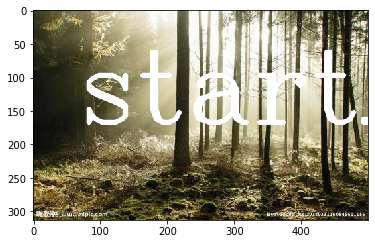

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: start_fire
Probability: 0.00%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


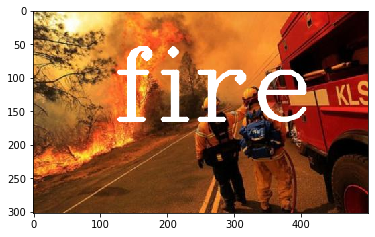

Top 1 ====================
Class name: no_fire
Probability: 99.99%
Top 2 ====================
Class name: start_fire
Probability: 0.01%
Top 3 ====================
Class name: fire
Probability: 0.00%


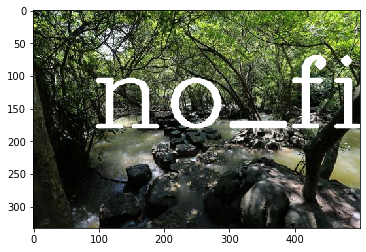

Top 1 ====================
Class name: no_fire
Probability: 99.93%
Top 2 ====================
Class name: start_fire
Probability: 0.06%
Top 3 ====================
Class name: fire
Probability: 0.01%


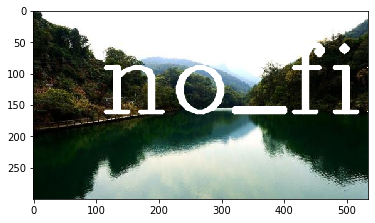

Top 1 ====================
Class name: start_fire
Probability: 96.78%
Top 2 ====================
Class name: fire
Probability: 1.91%
Top 3 ====================
Class name: no_fire
Probability: 1.31%


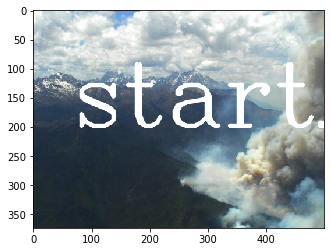

Top 1 ====================
Class name: no_fire
Probability: 99.93%
Top 2 ====================
Class name: start_fire
Probability: 0.07%
Top 3 ====================
Class name: fire
Probability: 0.00%


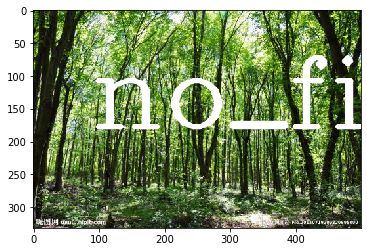

Top 1 ====================
Class name: start_fire
Probability: 99.99%
Top 2 ====================
Class name: fire
Probability: 0.01%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


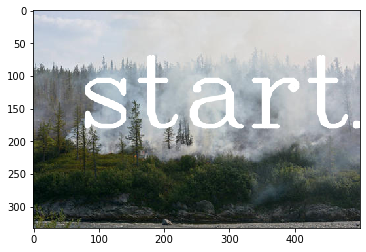

Top 1 ====================
Class name: no_fire
Probability: 99.98%
Top 2 ====================
Class name: start_fire
Probability: 0.01%
Top 3 ====================
Class name: fire
Probability: 0.01%


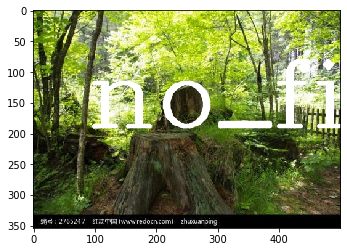

Top 1 ====================
Class name: no_fire
Probability: 99.18%
Top 2 ====================
Class name: fire
Probability: 0.74%
Top 3 ====================
Class name: start_fire
Probability: 0.08%


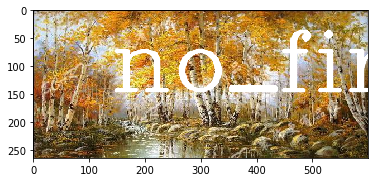

Top 1 ====================
Class name: start_fire
Probability: 99.67%
Top 2 ====================
Class name: no_fire
Probability: 0.20%
Top 3 ====================
Class name: fire
Probability: 0.13%


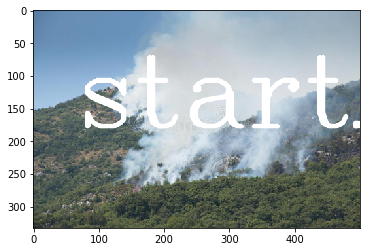

Top 1 ====================
Class name: start_fire
Probability: 90.66%
Top 2 ====================
Class name: fire
Probability: 8.63%
Top 3 ====================
Class name: no_fire
Probability: 0.71%


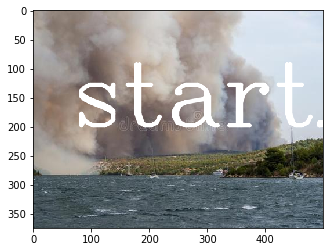

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: start_fire
Probability: 0.00%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


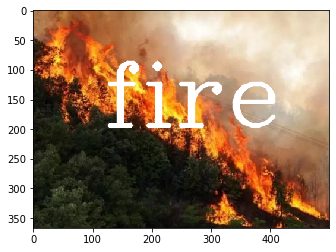

Top 1 ====================
Class name: no_fire
Probability: 99.97%
Top 2 ====================
Class name: start_fire
Probability: 0.02%
Top 3 ====================
Class name: fire
Probability: 0.01%


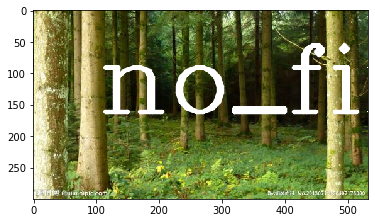

Top 1 ====================
Class name: start_fire
Probability: 49.30%
Top 2 ====================
Class name: no_fire
Probability: 38.88%
Top 3 ====================
Class name: fire
Probability: 11.82%


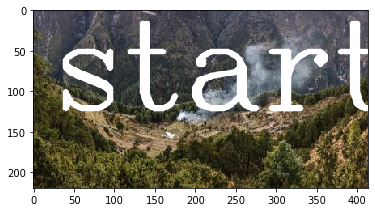

Top 1 ====================
Class name: fire
Probability: 99.99%
Top 2 ====================
Class name: no_fire
Probability: 0.01%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


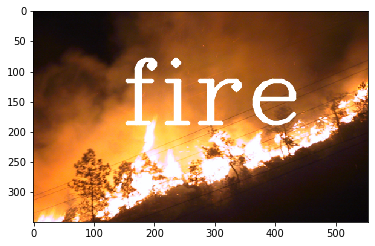

Top 1 ====================
Class name: fire
Probability: 99.95%
Top 2 ====================
Class name: no_fire
Probability: 0.05%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


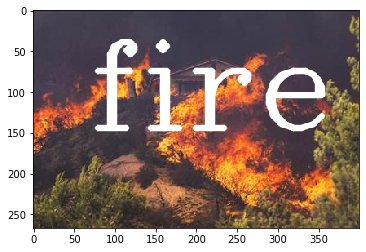

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


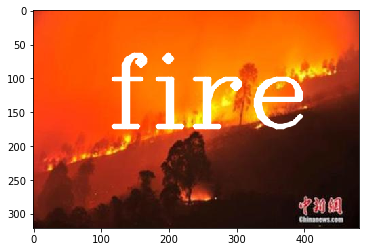

Top 1 ====================
Class name: no_fire
Probability: 99.66%
Top 2 ====================
Class name: start_fire
Probability: 0.20%
Top 3 ====================
Class name: fire
Probability: 0.13%


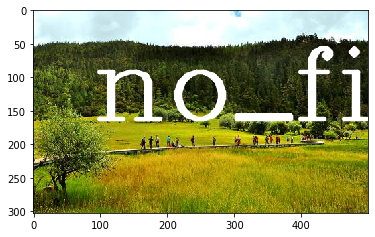

Top 1 ====================
Class name: fire
Probability: 99.97%
Top 2 ====================
Class name: no_fire
Probability: 0.03%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


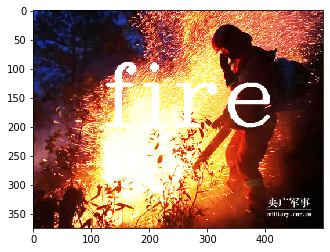

Top 1 ====================
Class name: no_fire
Probability: 99.94%
Top 2 ====================
Class name: fire
Probability: 0.04%
Top 3 ====================
Class name: start_fire
Probability: 0.02%


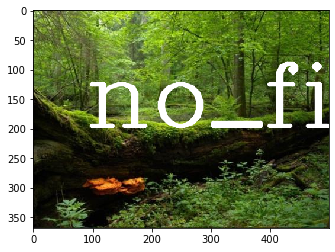

Top 1 ====================
Class name: start_fire
Probability: 99.87%
Top 2 ====================
Class name: fire
Probability: 0.13%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


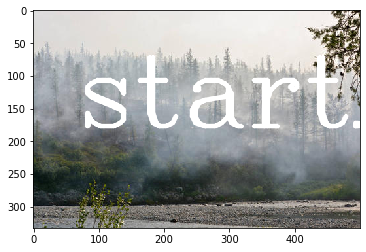

Top 1 ====================
Class name: fire
Probability: 99.97%
Top 2 ====================
Class name: no_fire
Probability: 0.03%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


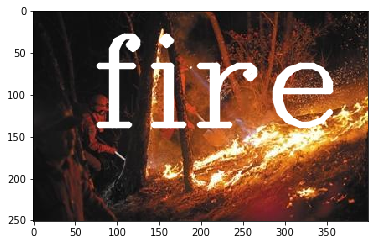

Top 1 ====================
Class name: fire
Probability: 71.99%
Top 2 ====================
Class name: start_fire
Probability: 26.31%
Top 3 ====================
Class name: no_fire
Probability: 1.71%


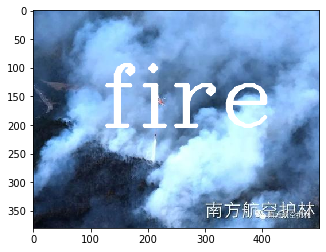

Top 1 ====================
Class name: fire
Probability: 99.98%
Top 2 ====================
Class name: no_fire
Probability: 0.02%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


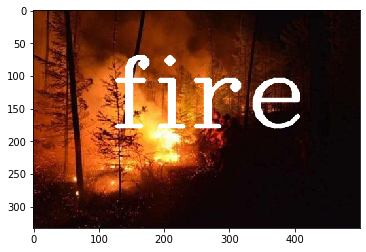

Top 1 ====================
Class name: start_fire
Probability: 73.58%
Top 2 ====================
Class name: fire
Probability: 17.27%
Top 3 ====================
Class name: no_fire
Probability: 9.15%


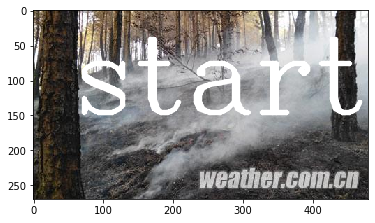

Top 1 ====================
Class name: fire
Probability: 98.79%
Top 2 ====================
Class name: start_fire
Probability: 1.17%
Top 3 ====================
Class name: no_fire
Probability: 0.03%


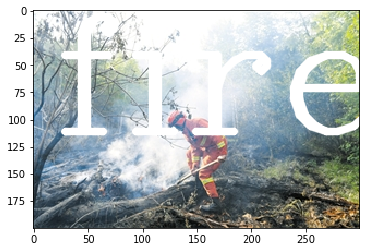

Top 1 ====================
Class name: no_fire
Probability: 100.00%
Top 2 ====================
Class name: start_fire
Probability: 0.00%
Top 3 ====================
Class name: fire
Probability: 0.00%


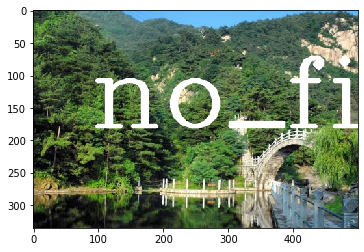

Top 1 ====================
Class name: no_fire
Probability: 99.84%
Top 2 ====================
Class name: start_fire
Probability: 0.14%
Top 3 ====================
Class name: fire
Probability: 0.02%


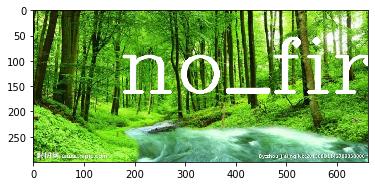

Top 1 ====================
Class name: fire
Probability: 98.57%
Top 2 ====================
Class name: start_fire
Probability: 1.07%
Top 3 ====================
Class name: no_fire
Probability: 0.35%


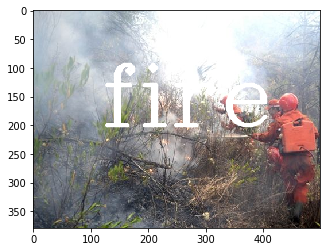

Top 1 ====================
Class name: no_fire
Probability: 99.98%
Top 2 ====================
Class name: fire
Probability: 0.01%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


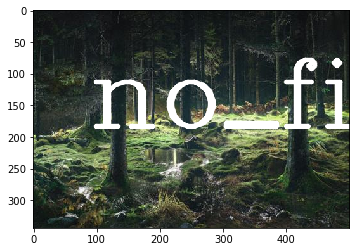

Top 1 ====================
Class name: fire
Probability: 97.45%
Top 2 ====================
Class name: start_fire
Probability: 1.60%
Top 3 ====================
Class name: no_fire
Probability: 0.95%


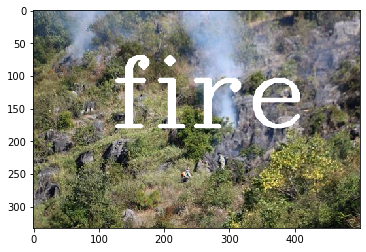

Top 1 ====================
Class name: fire
Probability: 99.98%
Top 2 ====================
Class name: start_fire
Probability: 0.02%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


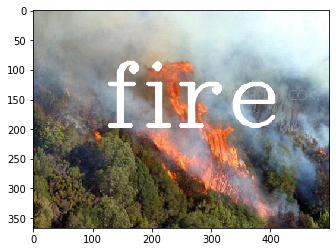

Top 1 ====================
Class name: fire
Probability: 99.77%
Top 2 ====================
Class name: no_fire
Probability: 0.18%
Top 3 ====================
Class name: start_fire
Probability: 0.05%


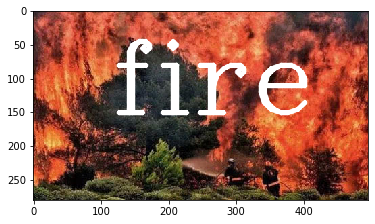

Top 1 ====================
Class name: no_fire
Probability: 100.00%
Top 2 ====================
Class name: start_fire
Probability: 0.00%
Top 3 ====================
Class name: fire
Probability: 0.00%


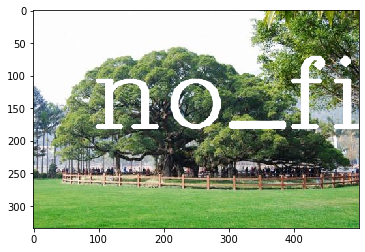

Top 1 ====================
Class name: fire
Probability: 99.55%
Top 2 ====================
Class name: no_fire
Probability: 0.45%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


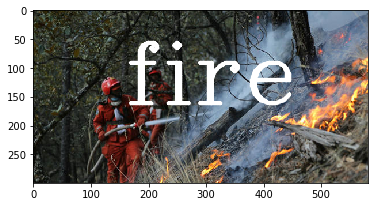

Top 1 ====================
Class name: fire
Probability: 99.88%
Top 2 ====================
Class name: start_fire
Probability: 0.10%
Top 3 ====================
Class name: no_fire
Probability: 0.02%


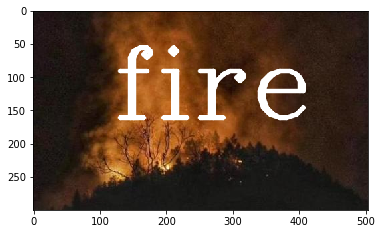

Top 1 ====================
Class name: fire
Probability: 97.66%
Top 2 ====================
Class name: no_fire
Probability: 2.33%
Top 3 ====================
Class name: start_fire
Probability: 0.01%


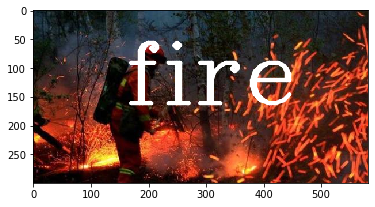

Top 1 ====================
Class name: no_fire
Probability: 99.99%
Top 2 ====================
Class name: start_fire
Probability: 0.01%
Top 3 ====================
Class name: fire
Probability: 0.00%


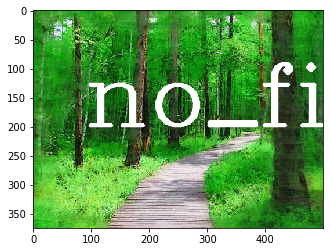

Top 1 ====================
Class name: fire
Probability: 51.62%
Top 2 ====================
Class name: no_fire
Probability: 45.37%
Top 3 ====================
Class name: start_fire
Probability: 3.01%


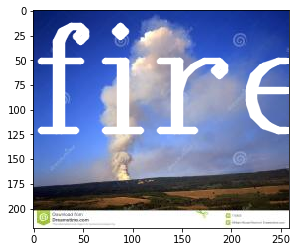

Top 1 ====================
Class name: fire
Probability: 99.98%
Top 2 ====================
Class name: no_fire
Probability: 0.02%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


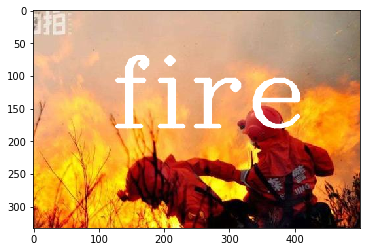

Top 1 ====================
Class name: fire
Probability: 85.31%
Top 2 ====================
Class name: start_fire
Probability: 12.98%
Top 3 ====================
Class name: no_fire
Probability: 1.72%


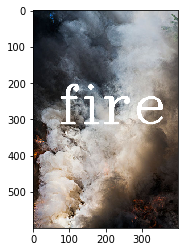

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


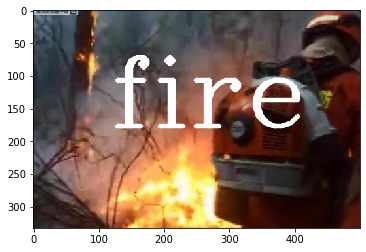

Top 1 ====================
Class name: no_fire
Probability: 89.47%
Top 2 ====================
Class name: start_fire
Probability: 7.09%
Top 3 ====================
Class name: fire
Probability: 3.44%


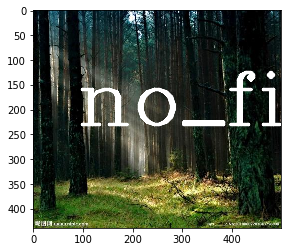

Top 1 ====================
Class name: no_fire
Probability: 99.86%
Top 2 ====================
Class name: start_fire
Probability: 0.11%
Top 3 ====================
Class name: fire
Probability: 0.02%


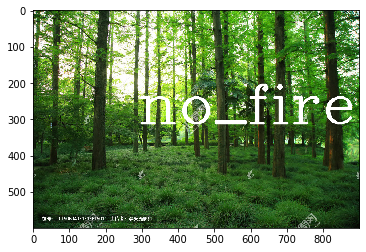

Top 1 ====================
Class name: no_fire
Probability: 96.13%
Top 2 ====================
Class name: fire
Probability: 3.50%
Top 3 ====================
Class name: start_fire
Probability: 0.37%


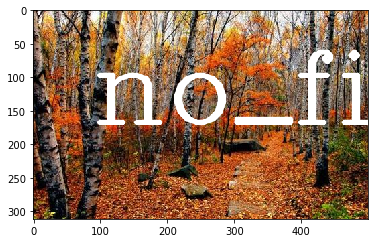

Top 1 ====================
Class name: fire
Probability: 99.21%
Top 2 ====================
Class name: no_fire
Probability: 0.63%
Top 3 ====================
Class name: start_fire
Probability: 0.16%


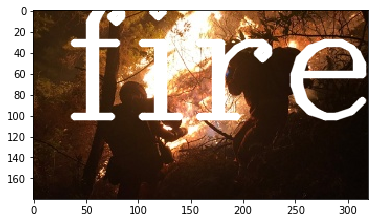

Top 1 ====================
Class name: start_fire
Probability: 59.01%
Top 2 ====================
Class name: fire
Probability: 40.74%
Top 3 ====================
Class name: no_fire
Probability: 0.25%


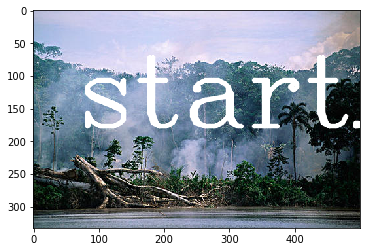

Top 1 ====================
Class name: no_fire
Probability: 99.95%
Top 2 ====================
Class name: fire
Probability: 0.03%
Top 3 ====================
Class name: start_fire
Probability: 0.02%


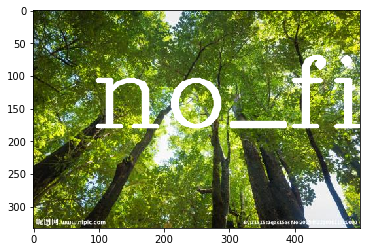

Top 1 ====================
Class name: no_fire
Probability: 98.52%
Top 2 ====================
Class name: start_fire
Probability: 0.77%
Top 3 ====================
Class name: fire
Probability: 0.71%


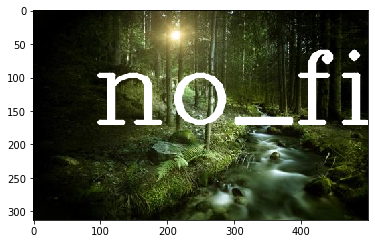

Top 1 ====================
Class name: start_fire
Probability: 53.85%
Top 2 ====================
Class name: no_fire
Probability: 35.86%
Top 3 ====================
Class name: fire
Probability: 10.29%


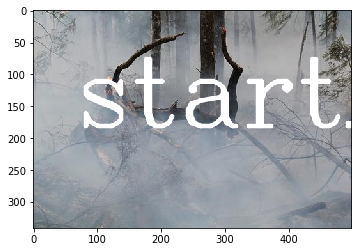

Top 1 ====================
Class name: fire
Probability: 96.15%
Top 2 ====================
Class name: no_fire
Probability: 3.42%
Top 3 ====================
Class name: start_fire
Probability: 0.43%


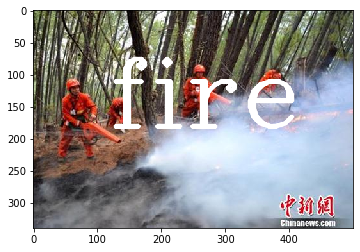

Top 1 ====================
Class name: fire
Probability: 95.75%
Top 2 ====================
Class name: start_fire
Probability: 4.20%
Top 3 ====================
Class name: no_fire
Probability: 0.05%


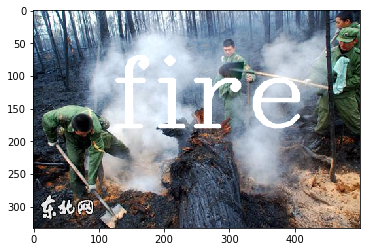

Top 1 ====================
Class name: start_fire
Probability: 99.43%
Top 2 ====================
Class name: no_fire
Probability: 0.54%
Top 3 ====================
Class name: fire
Probability: 0.03%


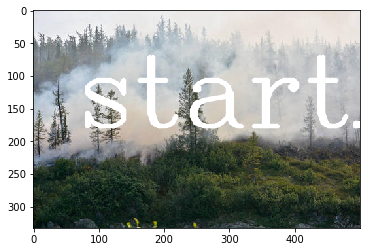

Top 1 ====================
Class name: no_fire
Probability: 100.00%
Top 2 ====================
Class name: start_fire
Probability: 0.00%
Top 3 ====================
Class name: fire
Probability: 0.00%


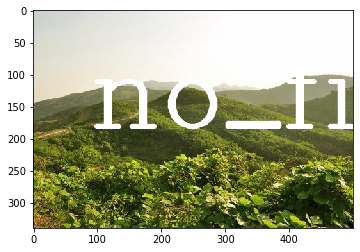

Top 1 ====================
Class name: no_fire
Probability: 99.85%
Top 2 ====================
Class name: fire
Probability: 0.13%
Top 3 ====================
Class name: start_fire
Probability: 0.02%


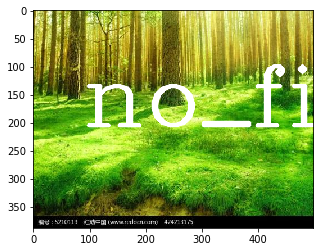

Top 1 ====================
Class name: start_fire
Probability: 99.97%
Top 2 ====================
Class name: fire
Probability: 0.03%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


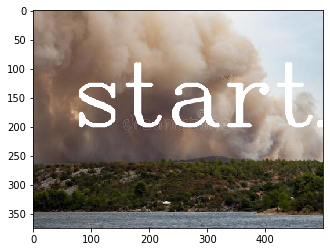

Top 1 ====================
Class name: start_fire
Probability: 94.32%
Top 2 ====================
Class name: fire
Probability: 4.59%
Top 3 ====================
Class name: no_fire
Probability: 1.09%


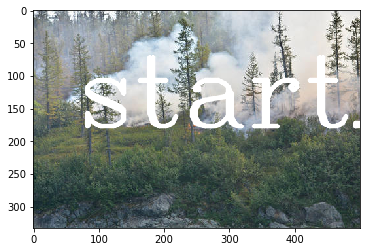

Top 1 ====================
Class name: fire
Probability: 99.98%
Top 2 ====================
Class name: no_fire
Probability: 0.02%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


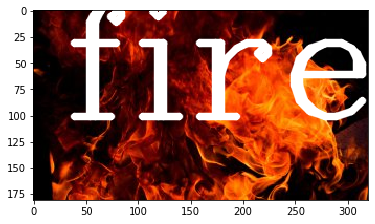

Top 1 ====================
Class name: start_fire
Probability: 65.00%
Top 2 ====================
Class name: no_fire
Probability: 33.75%
Top 3 ====================
Class name: fire
Probability: 1.26%


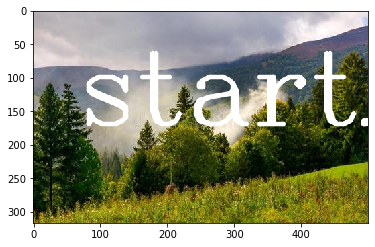

Top 1 ====================
Class name: no_fire
Probability: 100.00%
Top 2 ====================
Class name: fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


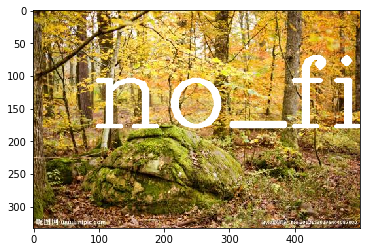

Top 1 ====================
Class name: no_fire
Probability: 78.43%
Top 2 ====================
Class name: start_fire
Probability: 17.83%
Top 3 ====================
Class name: fire
Probability: 3.73%


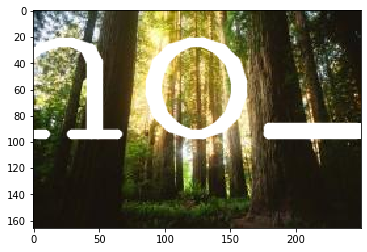

Top 1 ====================
Class name: no_fire
Probability: 99.98%
Top 2 ====================
Class name: fire
Probability: 0.02%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


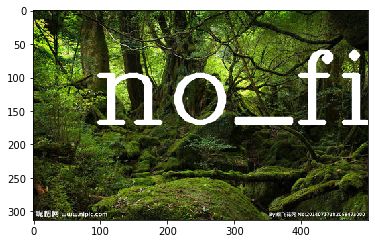

Top 1 ====================
Class name: fire
Probability: 99.97%
Top 2 ====================
Class name: no_fire
Probability: 0.03%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


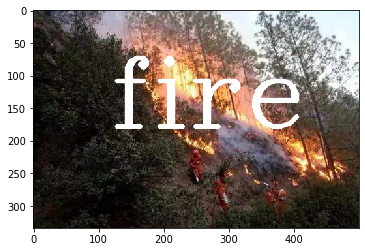

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: no_fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


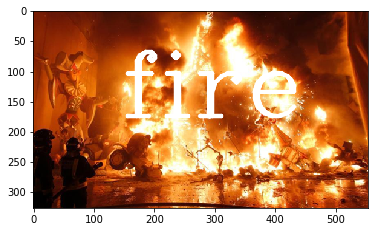

Top 1 ====================
Class name: fire
Probability: 89.98%
Top 2 ====================
Class name: no_fire
Probability: 10.00%
Top 3 ====================
Class name: start_fire
Probability: 0.02%


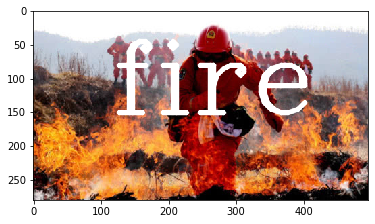

Top 1 ====================
Class name: no_fire
Probability: 99.56%
Top 2 ====================
Class name: start_fire
Probability: 0.39%
Top 3 ====================
Class name: fire
Probability: 0.05%


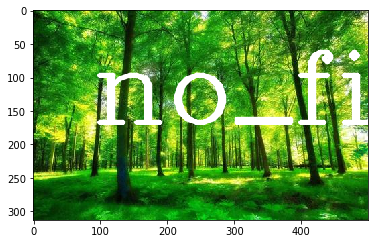

Top 1 ====================
Class name: fire
Probability: 99.96%
Top 2 ====================
Class name: no_fire
Probability: 0.03%
Top 3 ====================
Class name: start_fire
Probability: 0.01%


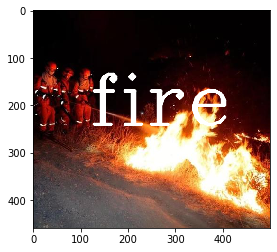

Top 1 ====================
Class name: fire
Probability: 99.54%
Top 2 ====================
Class name: no_fire
Probability: 0.45%
Top 3 ====================
Class name: start_fire
Probability: 0.01%


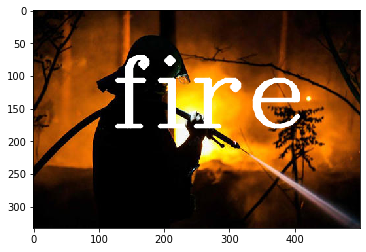

Top 1 ====================
Class name: fire
Probability: 91.92%
Top 2 ====================
Class name: no_fire
Probability: 7.94%
Top 3 ====================
Class name: start_fire
Probability: 0.14%


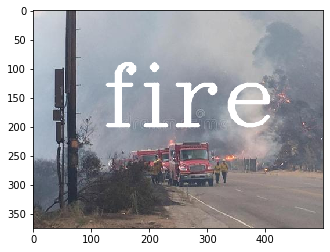

Top 1 ====================
Class name: fire
Probability: 99.80%
Top 2 ====================
Class name: no_fire
Probability: 0.20%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


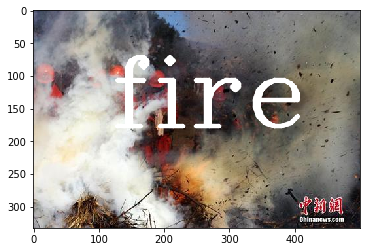

Top 1 ====================
Class name: fire
Probability: 100.00%
Top 2 ====================
Class name: start_fire
Probability: 0.00%
Top 3 ====================
Class name: no_fire
Probability: 0.00%


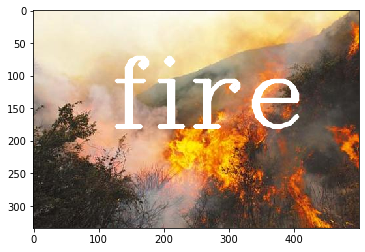

Top 1 ====================
Class name: start_fire
Probability: 99.55%
Top 2 ====================
Class name: no_fire
Probability: 0.25%
Top 3 ====================
Class name: fire
Probability: 0.20%


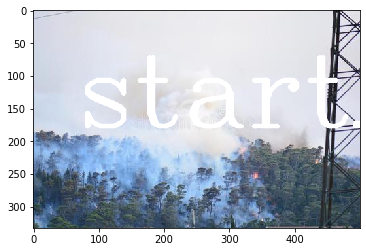

Top 1 ====================
Class name: no_fire
Probability: 99.96%
Top 2 ====================
Class name: start_fire
Probability: 0.02%
Top 3 ====================
Class name: fire
Probability: 0.02%


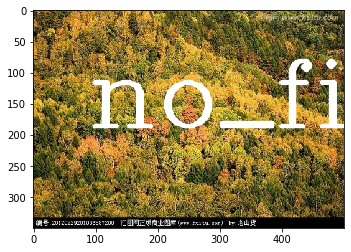

Top 1 ====================
Class name: fire
Probability: 84.83%
Top 2 ====================
Class name: start_fire
Probability: 15.07%
Top 3 ====================
Class name: no_fire
Probability: 0.10%


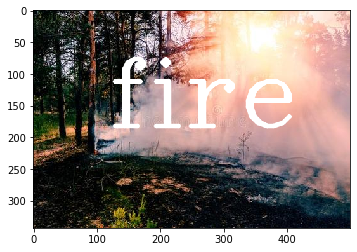

Top 1 ====================
Class name: fire
Probability: 99.99%
Top 2 ====================
Class name: no_fire
Probability: 0.01%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


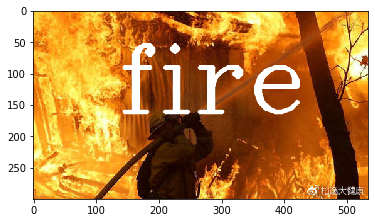

Top 1 ====================
Class name: fire
Probability: 84.30%
Top 2 ====================
Class name: no_fire
Probability: 15.66%
Top 3 ====================
Class name: start_fire
Probability: 0.03%


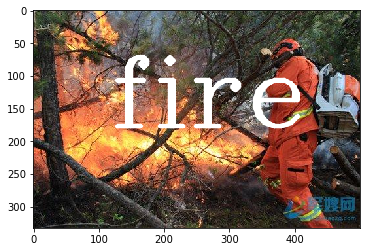

Top 1 ====================
Class name: no_fire
Probability: 99.97%
Top 2 ====================
Class name: fire
Probability: 0.02%
Top 3 ====================
Class name: start_fire
Probability: 0.01%


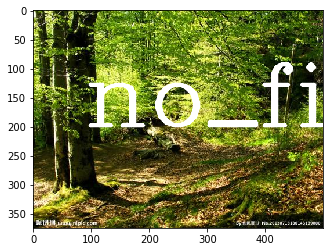

Top 1 ====================
Class name: no_fire
Probability: 100.00%
Top 2 ====================
Class name: fire
Probability: 0.00%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


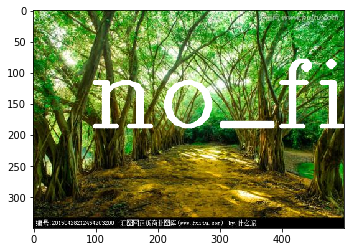

Top 1 ====================
Class name: fire
Probability: 99.99%
Top 2 ====================
Class name: no_fire
Probability: 0.01%
Top 3 ====================
Class name: start_fire
Probability: 0.00%


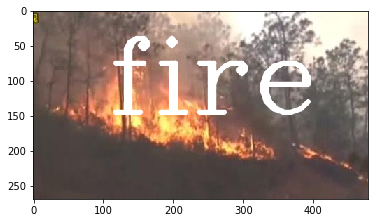

Top 1 ====================
Class name: start_fire
Probability: 93.91%
Top 2 ====================
Class name: no_fire
Probability: 6.02%
Top 3 ====================
Class name: fire
Probability: 0.08%


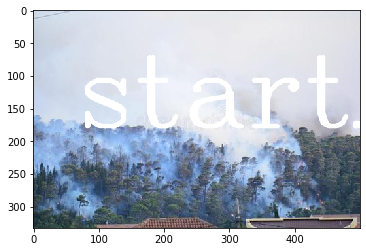

In [ ]:
graphically_test_model("best_trained_save.h5", classes, "datasets/test_database/Base de données de test", inception_preprocess_input, image_size=(224, 224))

In [ ]:
import cv2

def extract_hard_samples(model_path, preprocess_input, dataset_path, threshold,image_size=(224, 224)):
    """
    Extracts samples which are ard to classify for the network. Takes a dataset and a model as input, prediction is
    performed by the model on the samples from the dataset and samples with a classification confidence for the correct
    class lower than threshold are saved to a list.
    :return:
    """

    classes = ['fire', 'no_fire', 'start_fire']
    nbr_classes = 3

    #model = load_model(model_path)

    hard_examples = [[] for j in range(nbr_classes)]

    for i in range(nbr_classes):
        class_name = classes[i]
        for sample_path in os.listdir(dataset_path+"/"+class_name):
            print(sample_path)
            img = image.load_img(sample_path, target_size=image_size)
            # processed image to feed the network
            processed_img = image.img_to_array(img)
            processed_img = np.expand_dims(processed_img, axis=0)
            processed_img = preprocess_input(processed_img)

            # get prediction using the network
            predictions = model.predict(processed_img)[0]

            # prediction is not satisfactory
            if predictions[i] < threshold:
                hard_examples[i].append(sample_path)

    return hard_examples


In [ ]:
setup_full_dataset()

In [ ]:
def show_hard_samples(hard_examples, dataset_path):
    """
    Displays hard samples to classify. Samples must be in 1x3 list.
    """

    classes = ['fire', 'no_fire', 'start_fire']
    nbr_classes = 3

    for i in range(nbr_classes):
        class_name = classes[i]
        print("======= IMAGES OF "+class_name+" ========")
        for sample_path in hard_examples[i]:
            # load image for displaying
            img = cv2.imread(dataset_path + "/" + class_name + "/" + sample_path)
            # transform into RGB
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            plt.imshow(img)
            plt.show()

======= IMAGES OF fire ========


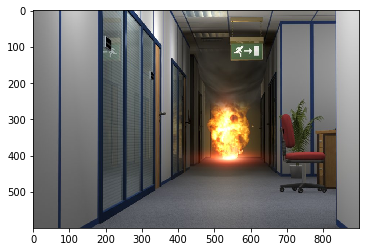

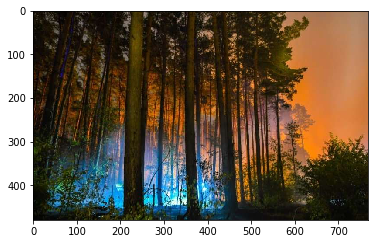

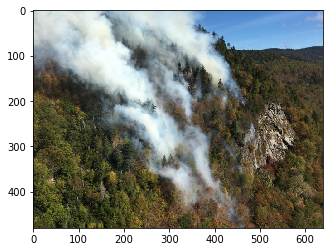

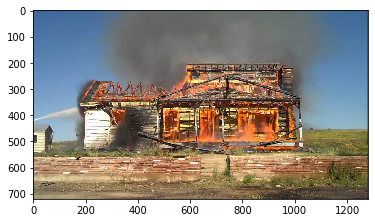

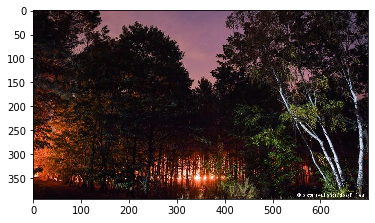

======= IMAGES OF no_fire ========


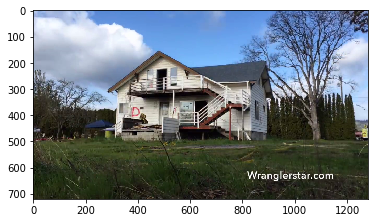

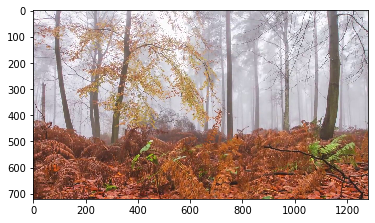

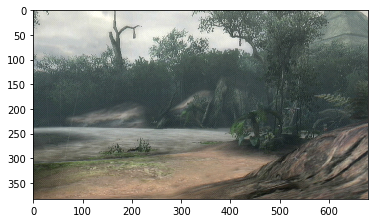

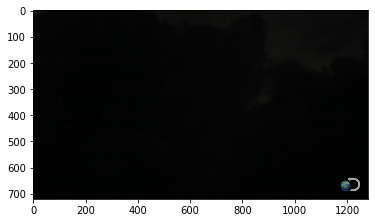

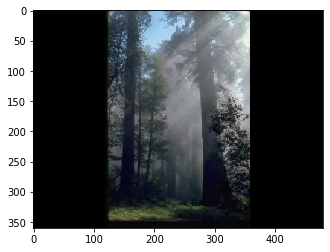

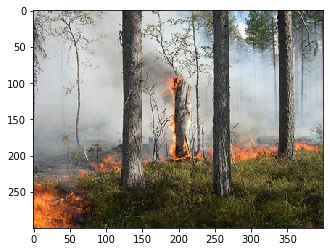

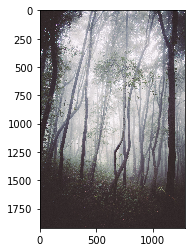

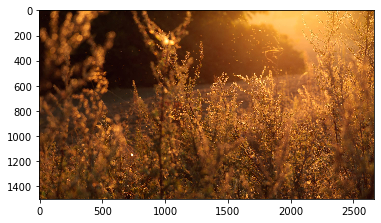

======= IMAGES OF start_fire ========


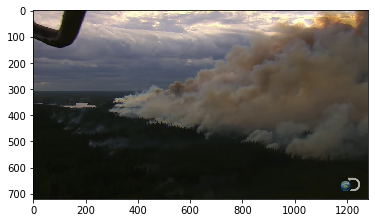

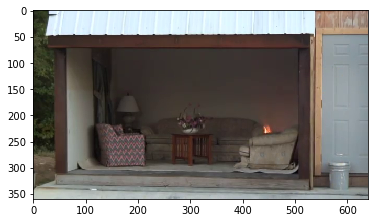

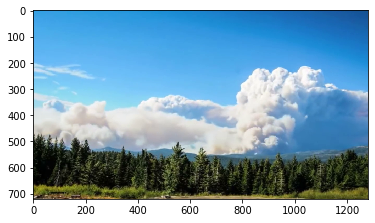

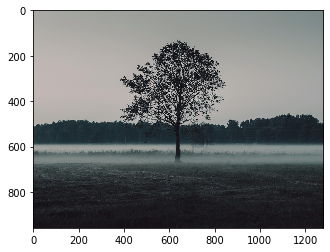

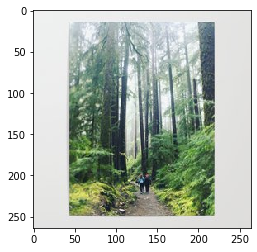

...

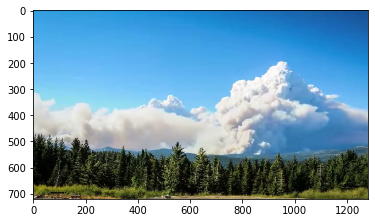

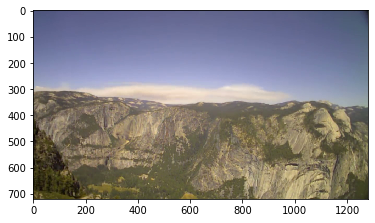

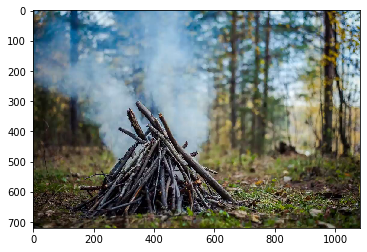

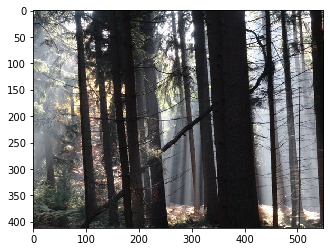

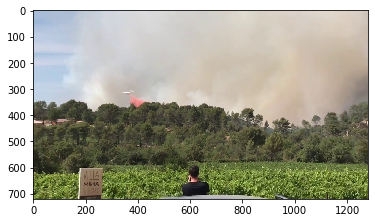

In [ ]:
# 0.33 threshold on all
third = [['913_0.jpg', '00000253.jpg', '00000386.jpg', 'maison (85).png', '00000185.jpg'], ['maisonbis (1).png', 'Autumn (13).png', '00000264.jpg', 'NorthAmerica (14).png', '46.png', '00000149.jpg', 'Nature15.jpg', 'Wheat3.jpg'], ['NorthAmerica (4).png', '12.png', '133.png', '00000169.jpg', '00000162.jpg', '166.png', '118.png', '00000172.jpg', '13.png', '00000143.jpg', '00000065.jpg', '129.png', '116.png', '00000064.jpg', '128.png', '177.png', '182.png', '130.png', '181.png', '00000121.jpg', '178.png', '183.png', '00000157.jpg', 'Orgon (33).png', '126.png', '185.png', '0.png', '00000129.jpg', 'SaintCana (43).png']]

show_hard_samples(third,"datasets/all/")

======= IMAGES OF fire ========


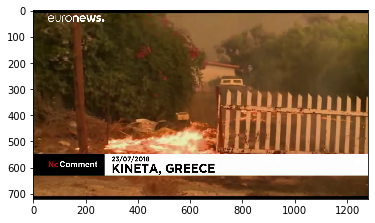

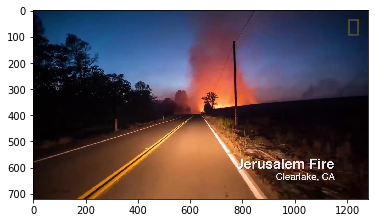

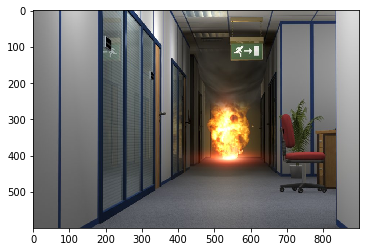

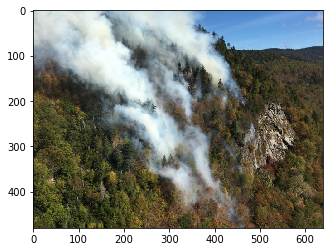

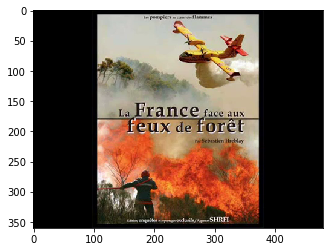

...

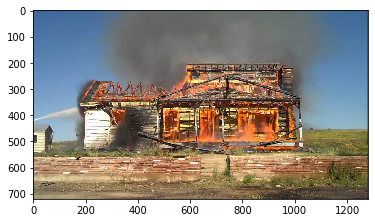

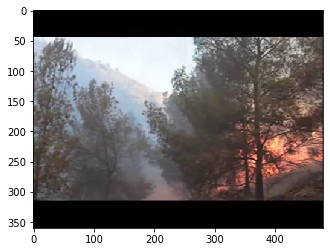

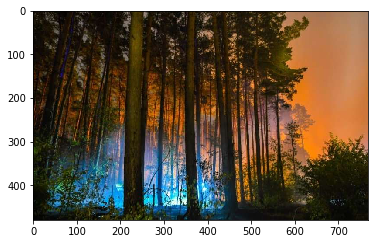

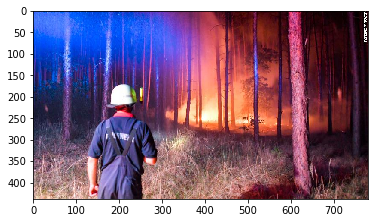

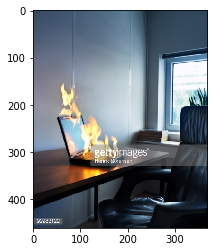

======= IMAGES OF no_fire ========


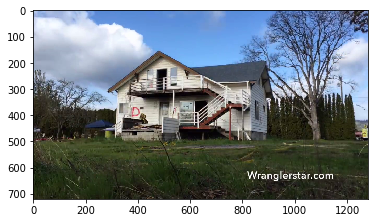

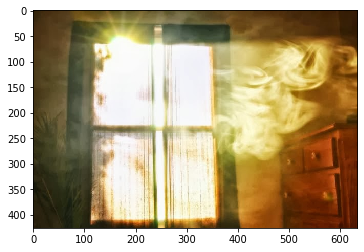

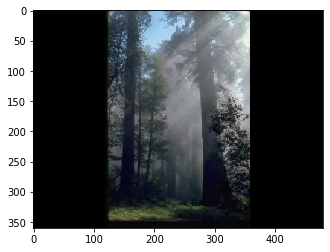

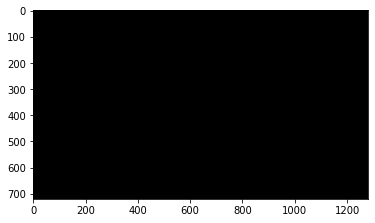

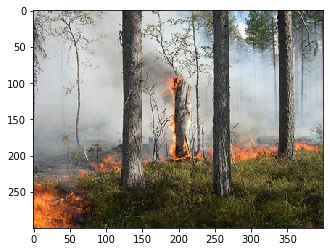

...

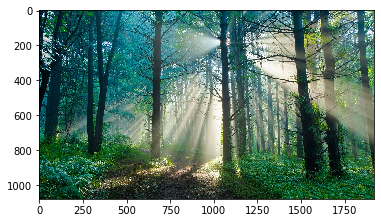

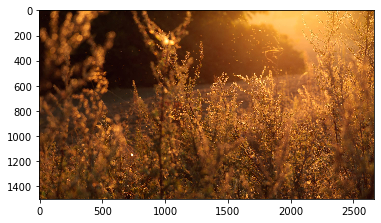

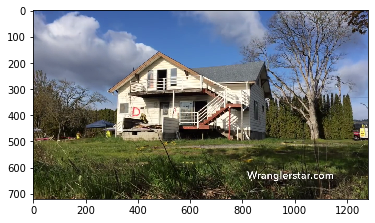

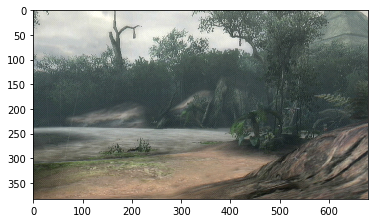

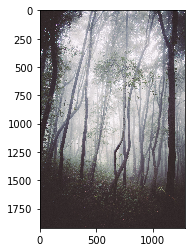

======= IMAGES OF start_fire ========


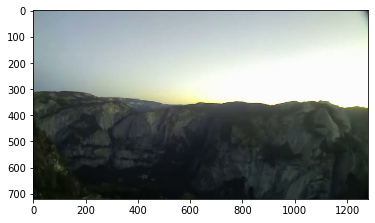

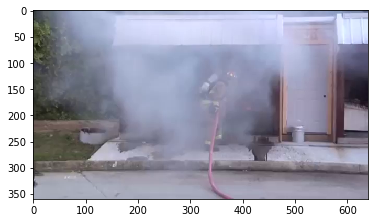

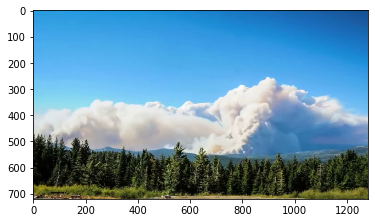

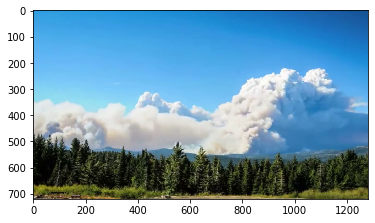

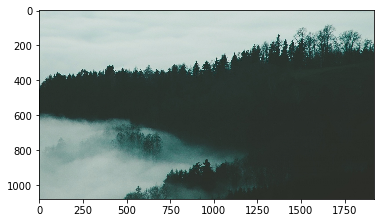

...

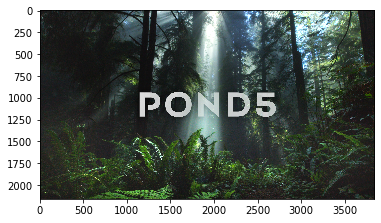

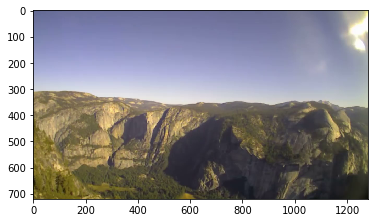

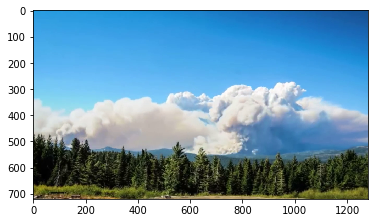

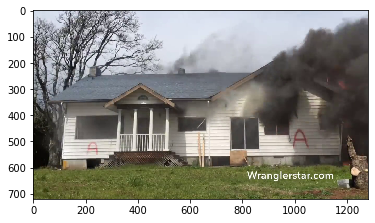

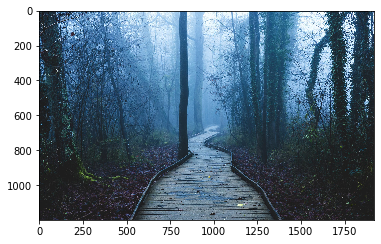

In [ ]:
# 0.6 threshold on all
sixty = [['Athenesbis (12).png', 'California (82).png', '913_0.jpg', '00000386.jpg', 'Orgon (99).png', '00000185.jpg', '00000043.jpg', '2970的副本.png', '00000339.jpg', 'maison (85).png', 'Orgon (123).png', '00000253.jpg', '00000380.jpg', '92983122.jpg'], ['maisonbis (1).png', 'Problem-smoke-bedroom.jpg', '46.png', 'NorthAmerica (6).png', '00000149.jpg', 'Autumn (13).png', 'NorthAmerica (14).png', '00000144.jpg', 'Wheat3.jpg', 'maisonbis (2).png', '00000264.jpg', 'Nature15.jpg'], ['177.png', 'Trompe (16).png', '121.png', '128.png', '00000161.jpg', '00000068.jpg', 'Orgon (33).png', '00000162.jpg', '184.png', '132.png', '185.png', '126.png', '166.png', 'Trompe (15).png', '133.png', '130.png', 'NorthAmerica (73).png', '129.png', '00000143.jpg', 'NorthAmerica (4).png', '00000064.jpg', '00000026.jpg', '195.png', '179.png', '167.png', '178.png', '13.png', '12.png', '134.png', '183.png', 'hesitationBormesMisomas (73).png', '00000065.jpg', '189.png', '00000172.jpg', '135.png', 'SaintCana (43).png', 'SaintCana (325).png', '00000121.jpg', '0.png', '116.png', '00000129.jpg', '118.png', '181.png', '00000055.jpg', '00000169.jpg', '182.png', '00000157.jpg', '180.png', '117.png', 'maisonbisbis (8).png', '00000125.jpg']]
show_hard_samples(sixty,"datasets/all/")